# Data & Preprocessing

Once the dataset is downloaded and extracted, we can begin exploratory analysis.

> To reach this point, perform the following command:
>
> ```bash
> python main.py download # Downloads the dataset of choice (see config/dataset.json) and extracts
> ```

## Setup

Import the necessary dependencies

In [1]:
import torch
import numpy as np
import os
import sys
import json

from PIL import Image
from pathlib import Path
from matplotlib import pyplot as plt

Import local modules

In [7]:
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

from lib.utils import mask, tile
from lib.config.data import CHOICE, IGNORE_COLOR, LABEL_COLORS, LABEL_NAMES
from lib.config.model import INPUT_SIZE
from lib.config.device import DEVICE

## Dataset File Structure

The images and labels are stored in the `data/{choice}/images/` and `data/{choice}/labels/` directories.

Images are `.tif` files, while their labels are `.png` files.

The `pillow` library provides support for both.

## Example

Let's take an example:

In [8]:
dataset_directory = Path(f"../data/{CHOICE}")

scene_id = None
with open((dataset_directory / "index.json").as_posix(), "r") as fd:
    scene_id = json.load(fd)["train"][0]

Load the image:

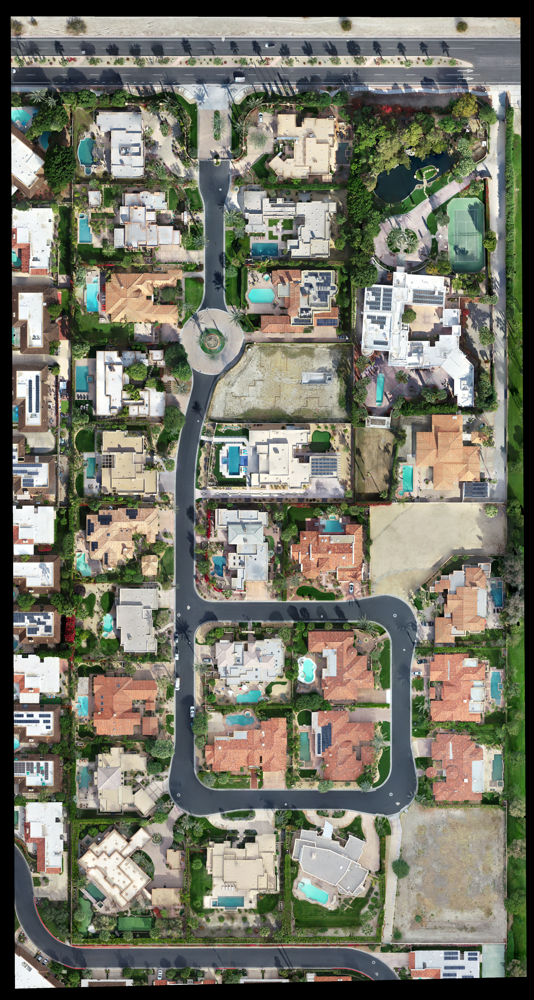

In [9]:
image = Image.open((dataset_directory / "images" / f"{scene_id}-ortho.tif").as_posix()).convert("RGB")
image

The above image has the following label:

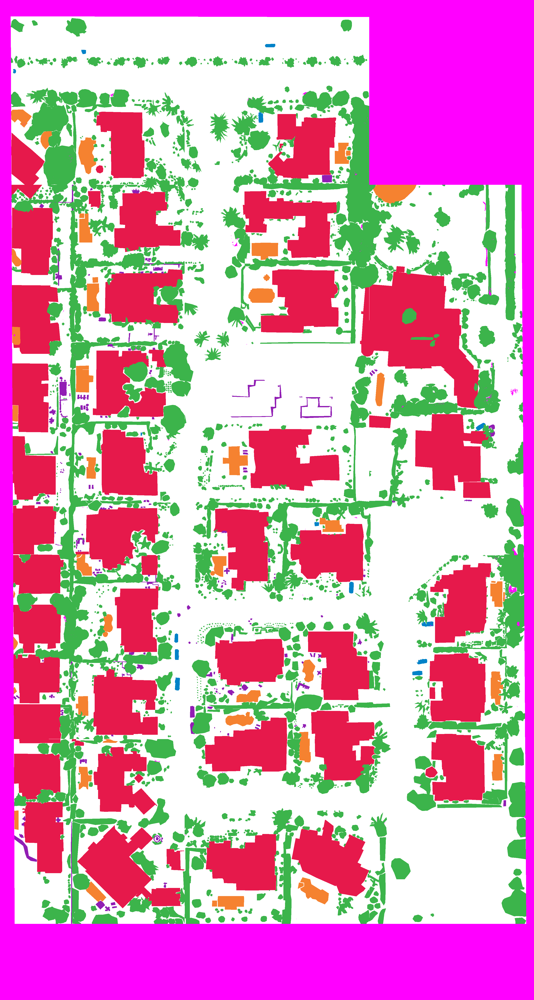

In [10]:
label = Image.open((dataset_directory / "labels" / f"{scene_id}-label.png").as_posix()).convert("RGB")
label

As you can see, each color represents a class of pixels.

Load the images as `torch` tensors

In [11]:
image = torch.from_numpy(np.array(image)).to(DEVICE)
label = torch.from_numpy(np.array(label)).to(DEVICE)

The image has the following shape:

In [12]:
image.shape

torch.Size([5542, 2962, 3])

`IGNORE_COLOR` is a torch tensor that contains the RGB value for pixels that are ignored:

In [13]:
IGNORE_COLOR

tensor([255,   0, 255], device='cuda:0')

## Masking

Let's define a simple function that provides a boolean mask of an input image tensor depending on the presence of a particular color.

```python
def mask(img, color):
    """
    Returns a Boolean mask on a image, based on the presence of a color.

    Arguments:
        img {torch.Tensor} -- image tensor
        color {torch.Tensor} -- RGB color tensor

    Returns:
        torch.BoolTensor -- boolean mask of image
    """
    dim = len(img.shape) - 1

    return torch.all(img == color.view(*([1] * dim), 3), dim=dim)
```

Let's try it on the label tensor:

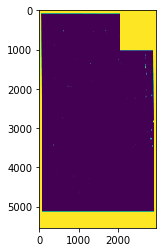

In [15]:
plt.imshow(mask(label, IGNORE_COLOR).cpu().numpy())

The plot corresponds to the mask of `IGNORE_COLOR` of the label.

## Tiling

Since the images in the dataset are not of a fixed size, creating tiles of these large files would improve the training process.

To do this, we need to define a function that tiles a large image tensor with a particular tile size:

```python
def tile(img, size):
    return img.unfold(0, size, size).unfold(1, size, size).unfold(2, 3, 3).squeeze()
```

Let's try it out on the image tensor

In [16]:
tiled_image = tile(image, 256)
tiled_image.shape

torch.Size([21, 11, 256, 256, 3])

We can choose a particular tile, and plot it.
For example, the tile at the 11th row and 3rd column looks like this:

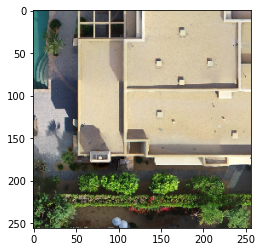

In [17]:
plt.imshow(tiled_image[10, 2].cpu().numpy())

Let's tile the label and mask out the tiles that have an `ignore_color` pixel:

In [20]:
tiled_label = tile(label, 256)

# Boolean tensor, masking tiles that have ignore_color pixels
keep = ~torch.any(torch.any(mask(tiled_label, IGNORE_COLOR), dim=3), dim=2)

# Keep only tiles that don't have ignore_color pixels
image_tiles = tiled_image[keep]
label_tiles = tiled_label[keep]

Let's check the shape of the final list of image tiles:

In [21]:
image_tiles.shape

torch.Size([81, 256, 256, 3])

Our data will look like this:

A single datapoint:


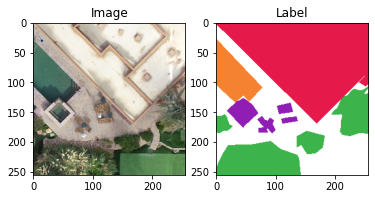

In [23]:
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.set_title("Image")
ax2.set_title("Label")
ax1.imshow(image_tiles[74].cpu().numpy())
ax2.imshow(label_tiles[74].cpu().numpy())
print("A single datapoint:")

## Command

To preprocess the images and labels in this manner, run the following command:

```bash
python main.py preprocess
```

It will generate the following:

```
├── data
│   └── {CHOICE}
│       └── tiles
│           └── x{INPUT_SIZE}
│               ├── images
│               ├── labels
│               └── split
```

- `train.txt` and `valid.txt` store filenames of the individual tiles.
- `tiles/images` contains all tiles of all images in the train and validation set.
- `tiles/labels` contains the correspoding label tiles.

> `CHOICE` and `INPUT_SIZE` can be set in [lib.config.data](../lib/config/data.py) and [lib.config.model](../lib/config/model.py)

## Multiple Masks

In order to train any segmentation model, we must create one-hot encoded versions of the labels of the input images.

> If this one-hot encoding is not done, the model will be much harder to train.
> It would instead try to get 'as close to' the right pixel value for each class.
>
> This is similar to a 'cat & dog' binary image classifier predicting 'dof' for an image that is clearly a 'dog'.
> It is being trained to figure out the label rather than identify it.

Here are the pixel values of the different classes

In [24]:
LABEL_COLORS

tensor([[230,  25,  75],
        [145,  30, 180],
        [ 60, 180,  75],
        [245, 130,  48],
        [255, 255, 255],
        [  0, 130, 200]], device='cuda:0')

In [25]:
LABEL_NAMES

['BUILDING', 'CLUTTER', 'VEGETATION', 'WATER', 'GROUND', 'CAR']

Let's compute the masks for the same tile:

A single datapoint:


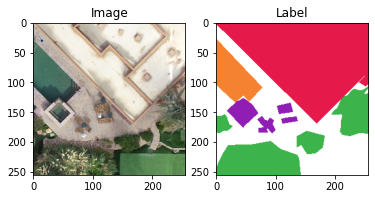

In [27]:
image_tile = Image.open((dataset_directory / "tiles" / f"x{INPUT_SIZE}" / "images" / f"{scene_id}-{75:06d}.png").as_posix()).convert("RGB")
label_tile = Image.open((dataset_directory / "tiles" / f"x{INPUT_SIZE}" / "labels" / f"{scene_id}-{75:06d}.png").as_posix()).convert("RGB")

image_tile = torch.from_numpy(np.array(image_tile)).to(DEVICE)
label_tile = torch.from_numpy(np.array(label_tile)).to(DEVICE)

# For the purpose of confirming that is the same tile, let's plot it again:
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.set_title("Image")
ax2.set_title("Label")
ax1.imshow(image_tile.cpu().numpy())
ax2.imshow(label_tile.cpu().numpy())
print("A single datapoint:")

We can use the same function we defined earlier:

In [28]:
masks = torch.stack([mask(label_tile, color) for color in LABEL_COLORS]).type(torch.float32)

Let's plot these masks

In [ ]:
fig, ax = plt.subplots(1, 6, figsize=(20, 20))

for i in range(6):
    ax[i].set_title(names[i])
    ax[i].imshow(masks[i].numpy())

print("Multiple masks for the different classes:")

The `DroneDeployDataset` class performs these transformations at the time of item indexing